## Notebook for the exploratory analysis of the Sanger Nuclei dataset

- Created by Carlos Talavera-López Ph.D
- v191113

### Load required modules

In [1]:
import bbknn
import anndata
import numpy as np
import pandas as pd
import scanpy as sc

/opt/conda/lib/python3.7/site-packages/dask/config.py:161: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  data = yaml.load(f.read()) or {}


In [2]:
sc.settings.verbosity = 3
sc.logging.print_version_and_date()
sc.settings.set_figure_params(dpi = 160, color_map = 'RdPu', dpi_save = 180, vector_friendly = True, format = 'svg')

Running Scanpy 1.4.3 on 2019-12-09 10:01.


### Read in annotated AnnData file

- Samples were processed with CellRanger v3.0.1 using the GRCh38 v3.0.0 from CellRanger

In [3]:
sanger_nuclei = anndata.read_h5ad('/home/jovyan/experiments/0-generate_anndata_objects/sanger_heart_NucSeq_QCed_scrublet_cellranger_ct191205.h5ad')
sanger_nuclei.var_names_make_unique()
sanger_nuclei.shape

(208958, 33538)

# QC for Sanger nucseq dataset

In [4]:
sc.pp.filter_cells(sanger_nuclei, min_counts = 3)
sanger_nuclei.shape

(208958, 33538)

### Compute QC stats for nuclei

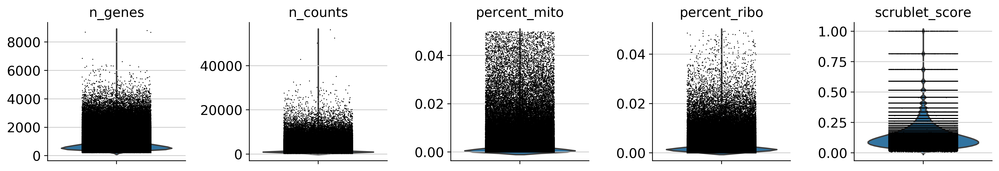

In [5]:
mito_nuclei = sanger_nuclei.var_names.str.startswith('MT-')
ribo_nuclei = sanger_nuclei.var_names.str.startswith('RPS','RPL')
sanger_nuclei.obs['percent_mito'] = np.sum(sanger_nuclei[:, mito_nuclei].X, axis = 1) / np.sum(sanger_nuclei.X, axis = 1)
sanger_nuclei.obs['percent_ribo'] = np.sum(sanger_nuclei[:, ribo_nuclei].X, axis = 1) / np.sum(sanger_nuclei.X, axis = 1)
sc.pl.violin(sanger_nuclei, ['n_genes', 'n_counts', 'percent_mito', 'percent_ribo', 'scrublet_score'],jitter = 0.25, multi_panel = True)

### Density plots for covariates

- Mitochondrial content

/opt/conda/lib/python3.7/site-packages/scanpy/plotting/_anndata.py:311: DeprecationWarning: Use obs_vector instead of _get_obs_array, _get_obs_array will be removed in the future.
  x_arr = adata._get_obs_array(x, use_raw=use_raw, layer=layers[0])
/opt/conda/lib/python3.7/site-packages/anndata/core/anndata.py:1475: FutureWarning: In a future version of AnnData, access to `.X` by passing `layer='X'` will be removed. Instead pass `layer=None`.
  FutureWarning
/opt/conda/lib/python3.7/site-packages/scanpy/plotting/_anndata.py:312: DeprecationWarning: Use obs_vector instead of _get_obs_array, _get_obs_array will be removed in the future.
  y_arr = adata._get_obs_array(y, use_raw=use_raw, layer=layers[1])
/opt/conda/lib/python3.7/site-packages/anndata/core/anndata.py:1475: FutureWarning: In a future version of AnnData, access to `.X` by passing `layer='X'` will be removed. Instead pass `layer=None`.
  FutureWarning


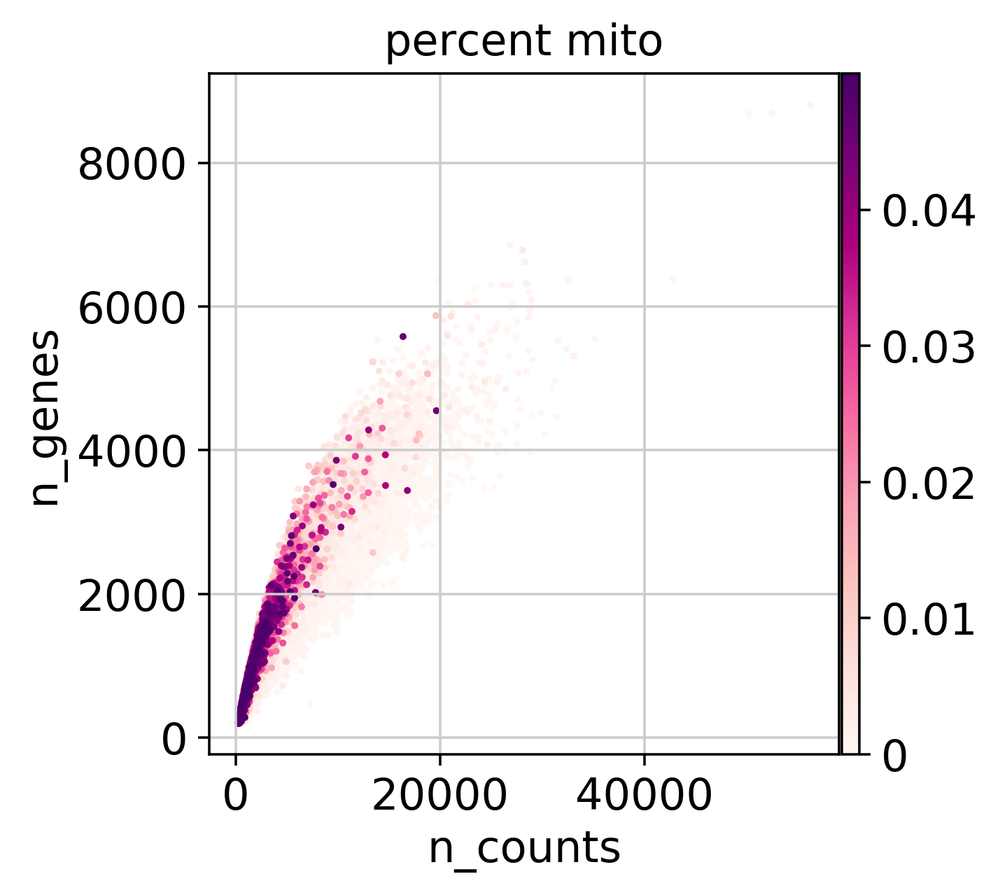

In [6]:
sc.pl.scatter(sanger_nuclei, 'n_counts', 'n_genes', color = 'percent_mito', size = 20)

- Ribosomal content

/opt/conda/lib/python3.7/site-packages/scanpy/plotting/_anndata.py:311: DeprecationWarning: Use obs_vector instead of _get_obs_array, _get_obs_array will be removed in the future.
  x_arr = adata._get_obs_array(x, use_raw=use_raw, layer=layers[0])
/opt/conda/lib/python3.7/site-packages/anndata/core/anndata.py:1475: FutureWarning: In a future version of AnnData, access to `.X` by passing `layer='X'` will be removed. Instead pass `layer=None`.
  FutureWarning
/opt/conda/lib/python3.7/site-packages/scanpy/plotting/_anndata.py:312: DeprecationWarning: Use obs_vector instead of _get_obs_array, _get_obs_array will be removed in the future.
  y_arr = adata._get_obs_array(y, use_raw=use_raw, layer=layers[1])
/opt/conda/lib/python3.7/site-packages/anndata/core/anndata.py:1475: FutureWarning: In a future version of AnnData, access to `.X` by passing `layer='X'` will be removed. Instead pass `layer=None`.
  FutureWarning


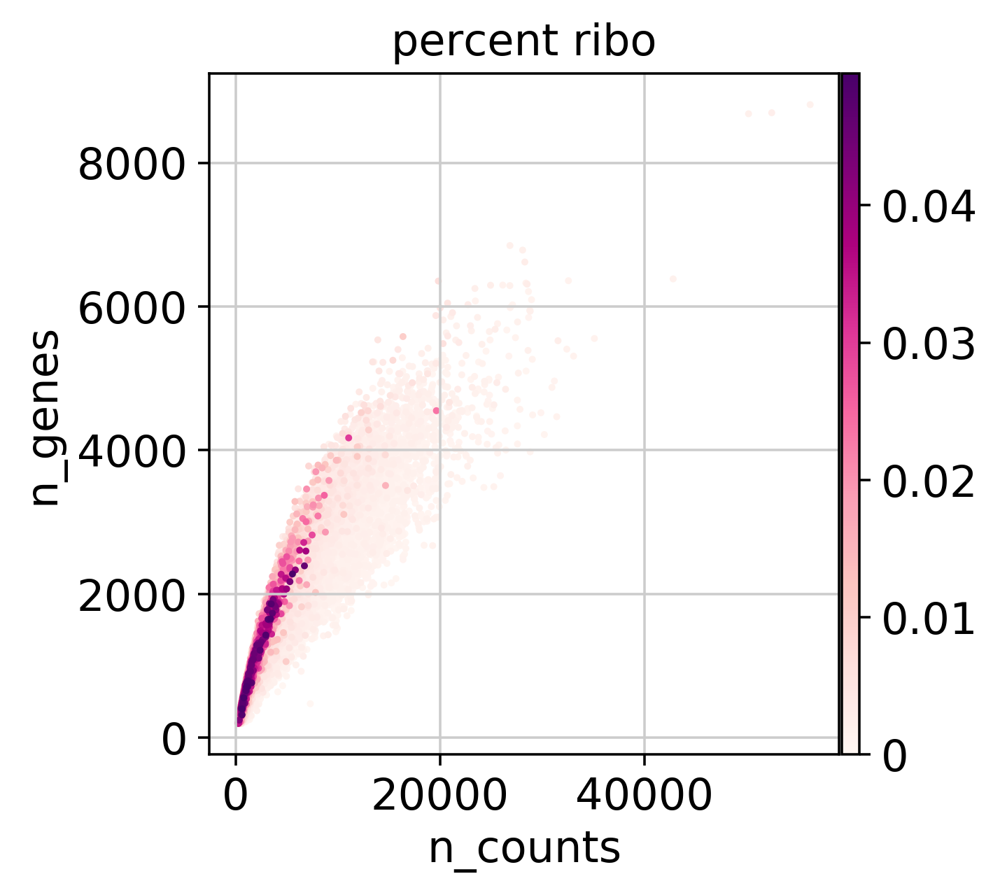

In [7]:
sc.pl.scatter(sanger_nuclei, 'n_counts', 'n_genes', color = 'percent_ribo', size = 20)

- Counts

In [8]:
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import colors
import seaborn as sb

plt.rcParams['figure.figsize']=(8,8)

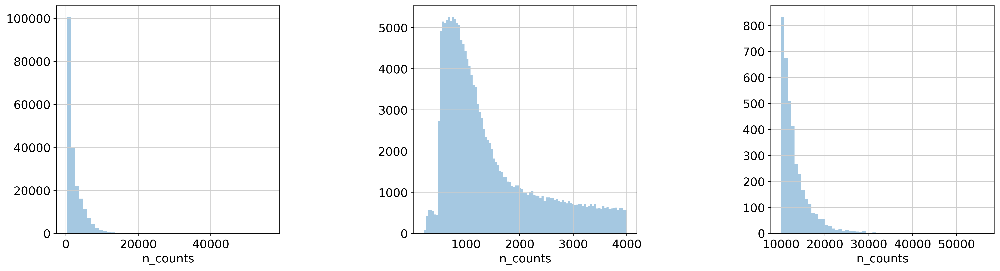

In [9]:
rcParams['figure.figsize'] = (20,5)
fig_ind = np.arange(131, 134)
fig = plt.figure()
fig.subplots_adjust(hspace = 0.4, wspace = 0.6)

sb.distplot(sanger_nuclei.obs['n_counts'], kde = False, ax = fig.add_subplot(fig_ind[0]))
sb.distplot(sanger_nuclei.obs['n_counts'][sanger_nuclei.obs['n_counts'] < 4000], kde = False, bins = 100, ax = fig.add_subplot(fig_ind[1]))
sb.distplot(sanger_nuclei.obs['n_counts'][sanger_nuclei.obs['n_counts'] > 10000], kde = False, bins = 60, ax = fig.add_subplot(fig_ind[2]))
plt.show()

- Genes

/opt/conda/lib/python3.7/site-packages/seaborn/distributions.py:198: RuntimeWarning: Mean of empty slice.
  line, = ax.plot(a.mean(), 0)
/opt/conda/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


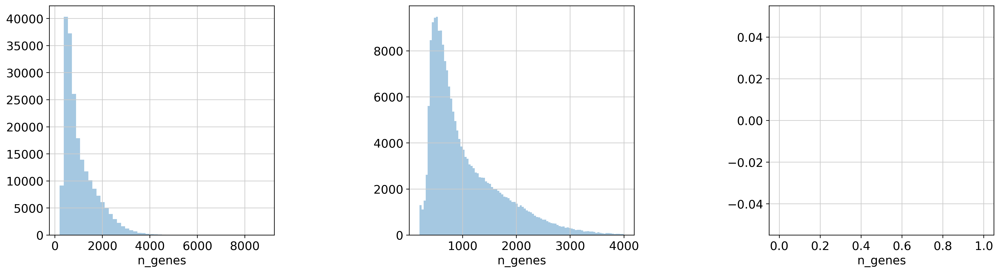

In [10]:
rcParams['figure.figsize'] = (20,5)
fig_ind = np.arange(131, 134)
fig = plt.figure()
fig.subplots_adjust(hspace = 0.4, wspace = 0.6)

sb.distplot(sanger_nuclei.obs['n_genes'], kde = False, ax = fig.add_subplot(fig_ind[0]))
sb.distplot(sanger_nuclei.obs['n_genes'][sanger_nuclei.obs['n_genes'] < 4000], kde = False, bins = 100, ax = fig.add_subplot(fig_ind[1]))
sb.distplot(sanger_nuclei.obs['n_genes'][sanger_nuclei.obs['n_genes'] > 10000], kde = False, bins = 60, ax = fig.add_subplot(fig_ind[2]))
plt.show()

- Scrublet score

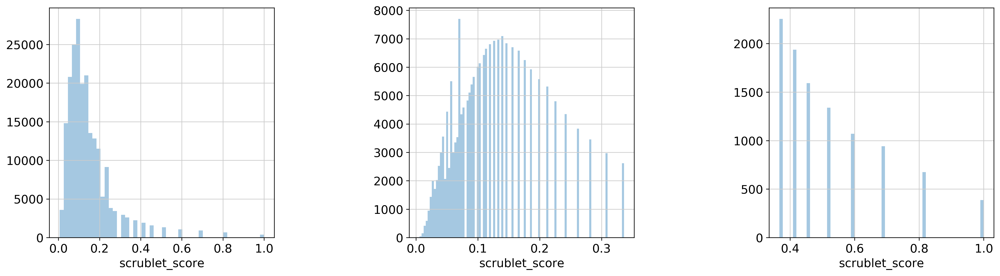

In [11]:
rcParams['figure.figsize'] = (20,5)
fig_ind = np.arange(131, 134)
fig = plt.figure()
fig.subplots_adjust(hspace = 0.4, wspace = 0.6)

sb.distplot(sanger_nuclei.obs['scrublet_score'], kde = False, ax = fig.add_subplot(fig_ind[0]))
sb.distplot(sanger_nuclei.obs['scrublet_score'][sanger_nuclei.obs['scrublet_score'] < 0.35], kde = False, bins = 100, ax = fig.add_subplot(fig_ind[1]))
sb.distplot(sanger_nuclei.obs['scrublet_score'][sanger_nuclei.obs['scrublet_score'] > 0.35], kde = False, bins = 60, ax = fig.add_subplot(fig_ind[2]))
plt.show()

- Mitochondrial content

/opt/conda/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in true_divide
  ret = ret.dtype.type(ret / rcount)


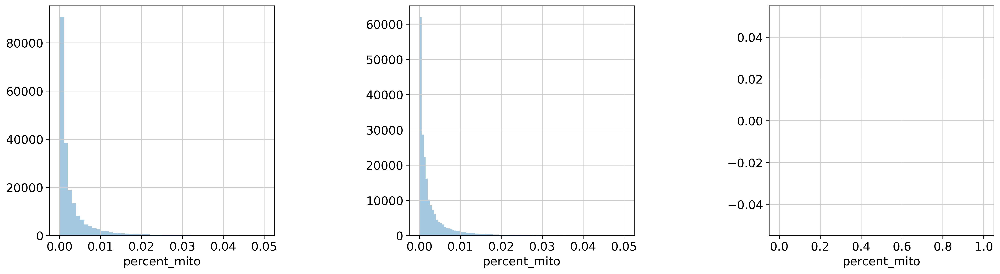

In [13]:
rcParams['figure.figsize'] = (20,5)
fig_ind = np.arange(131, 134)
fig = plt.figure()
fig.subplots_adjust(hspace = 0.4, wspace = 0.6)

sb.distplot(sanger_nuclei.obs['percent_mito'], kde = False, ax = fig.add_subplot(fig_ind[0]))
sb.distplot(sanger_nuclei.obs['percent_mito'][sanger_nuclei.obs['percent_mito'] < 0.1], kde = False, bins = 100, ax = fig.add_subplot(fig_ind[1]))
sb.distplot(sanger_nuclei.obs['percent_mito'][sanger_nuclei.obs['percent_mito'] > 0.1], kde = False, bins = 60, ax = fig.add_subplot(fig_ind[2]))
plt.show()

### Filter based on QC covariates

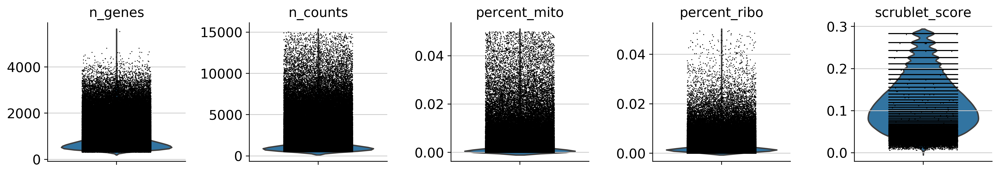

In [14]:
sanger_nuclei = sanger_nuclei[sanger_nuclei.obs['n_counts'] > 500]
sanger_nuclei = sanger_nuclei[sanger_nuclei.obs['n_counts'] < 15000]
sanger_nuclei = sanger_nuclei[sanger_nuclei.obs['n_genes'] > 300]
sanger_nuclei = sanger_nuclei[sanger_nuclei.obs['n_genes'] < 6000]
sanger_nuclei = sanger_nuclei[sanger_nuclei.obs['percent_mito'] < 0.05]
sanger_nuclei = sanger_nuclei[sanger_nuclei.obs['percent_ribo'] < 0.05]
sanger_nuclei = sanger_nuclei[sanger_nuclei.obs['scrublet_score'] < 0.3]
sc.pl.violin(sanger_nuclei, ['n_genes', 'n_counts', 'percent_mito', 'percent_ribo', 'scrublet_score'],jitter = 0.25, multi_panel = True)

In [15]:
sanger_nuclei.shape

(188378, 33538)

### Normalise and log data

In [16]:
nuclei_raw = sanger_nuclei.copy()
sc.pp.normalize_per_cell(sanger_nuclei, counts_per_cell_after = 1e4)
sc.pp.log1p(sanger_nuclei)
sanger_nuclei.raw = sanger_nuclei

### Identify and subset HVGs

In [17]:
sc.pp.highly_variable_genes(sanger_nuclei, flavor = "seurat")
nuclei_hvg = sanger_nuclei[:, sanger_nuclei.var['highly_variable']]
nuclei_hvg.shape

--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


(188378, 3773)

### Regress out cells with high counts and mitochondrial content

In [18]:
sc.pp.scale(nuclei_hvg, max_value = 10)

### Compute PCA 

computing PCA with n_comps = 50
computing PCA on highly variable genes
    finished (0:01:16.96)


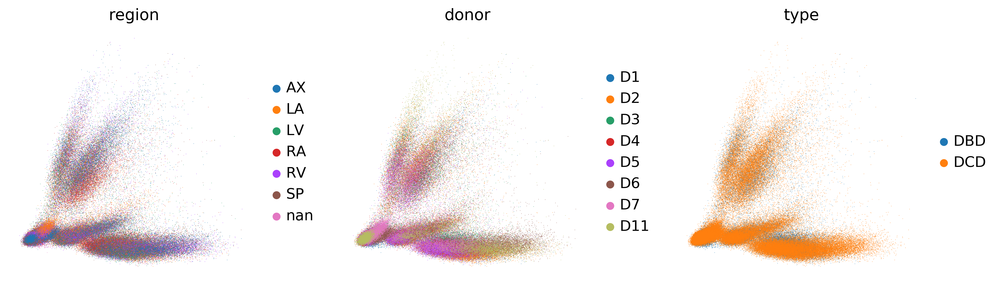

In [19]:
sc.settings.set_figure_params(dpi = 160, color_map = 'RdPu', dpi_save = 180, vector_friendly = True, format = 'svg')
sc.tl.pca(nuclei_hvg, svd_solver = 'arpack', random_state = 1969)
sc.pl.pca(nuclei_hvg, color = ['region', 'donor', 'type'], frameon = False)

### Calculate neighborhood graph and map embedding to UMAP

computing neighbors
    using 'X_pca' with n_pcs = 50


/opt/conda/lib/python3.7/site-packages/umap/rp_tree.py:450: NumbaWarning: 
Compilation is falling back to object mode WITH looplifting enabled because Function "make_euclidean_tree" failed type inference due to: Cannot unify RandomProjectionTreeNode(array(int64, 1d, C), bool, none, none, none, none) and RandomProjectionTreeNode(none, bool, array(float32, 1d, C), float64, RandomProjectionTreeNode(array(int64, 1d, C), bool, none, none, none, none), RandomProjectionTreeNode(array(int64, 1d, C), bool, none, none, none, none)) for '$14.16', defined at /opt/conda/lib/python3.7/site-packages/umap/rp_tree.py (457)

File "../../../opt/conda/lib/python3.7/site-packages/umap/rp_tree.py", line 457:
def make_euclidean_tree(data, indices, rng_state, leaf_size=30):
    <source elided>

        left_node = make_euclidean_tree(data, left_indices, rng_state, leaf_size)
        ^

[1] During: resolving callee type: recursive(type(CPUDispatcher(<function make_euclidean_tree at 0x7f2a947997b8>)))
[2] Durin

    finished (0:01:17.63) --> added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix
computing UMAP
    using 'X_pca' with n_pcs = 50
    finished (0:04:20.96) --> added
    'X_umap', UMAP coordinates (adata.obsm)


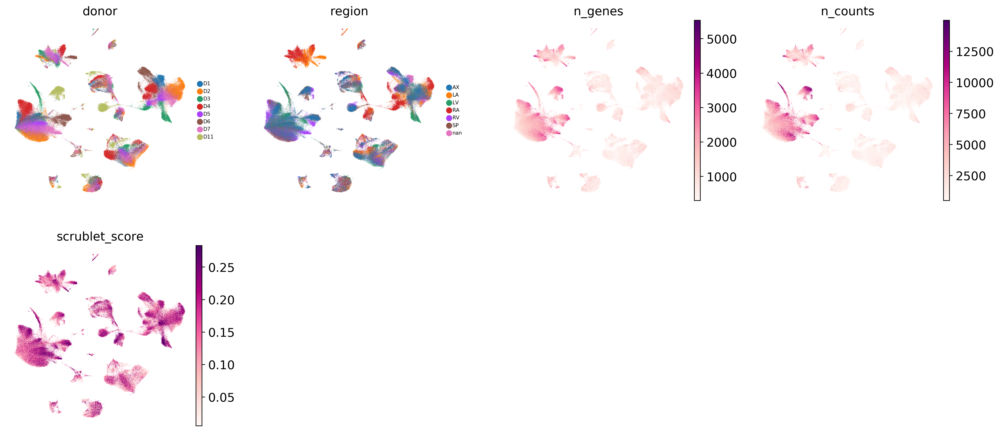

In [20]:
sc.pp.neighbors(nuclei_hvg, random_state = 1712)
sc.tl.umap(nuclei_hvg, min_dist = 0.3, spread = 1, random_state = 1712)
sc.pl.umap(nuclei_hvg, color = ['donor', 'region', 'n_genes', 'n_counts', 'scrublet_score'], size = 0.5, legend_fontsize = 6, color_map = 'RdPu', frameon = False)

/opt/conda/lib/python3.7/site-packages/anndata/core/anndata.py:299: FutureWarning: In anndata v0.7+, arrays contained within an AnnData object will maintain their dimensionality. For example, prior to v0.7 `adata[0, 0].X` returned a scalar and `adata[0, :]` returned a 1d array, post v0.7 they will return two dimensional arrays. If you would like to get a one dimensional array from your AnnData object, consider using the `adata.obs_vector`, `adata.var_vector` methods or accessing the array directly.
  warn_flatten()


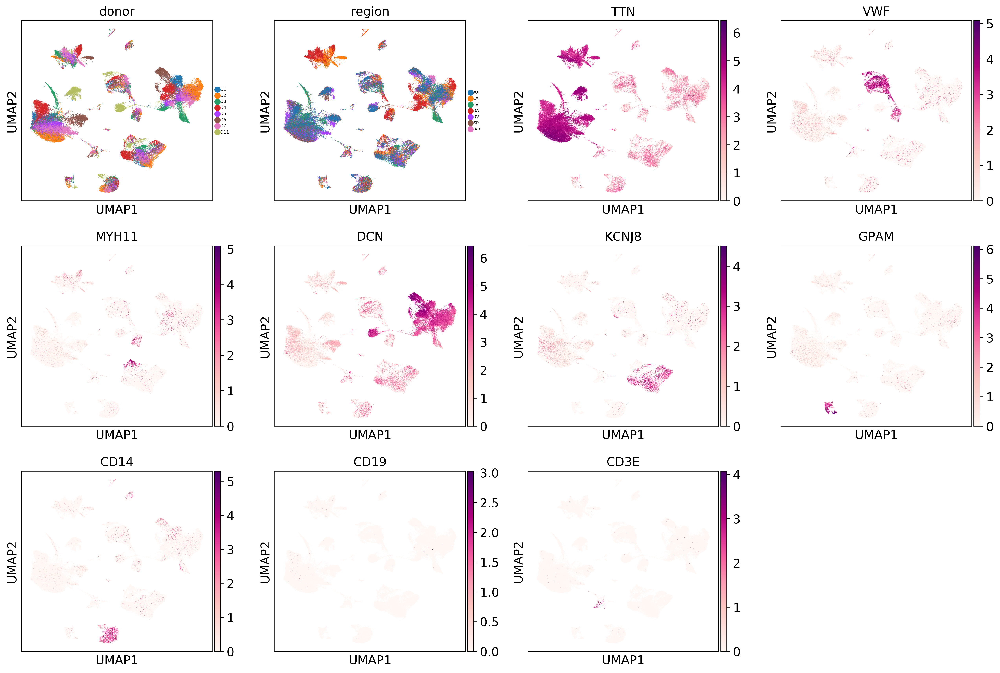

In [21]:
sc.pl.umap(nuclei_hvg, color = ['donor', 'region', 'TTN', 'VWF', 'MYH11', 'DCN', 'KCNJ8', 'GPAM', 'CD14', 'CD19', 'CD3E'], size = 0.5, legend_fontsize = 5, color_map = 'RdPu')

### Align datasets with bbknn using a combination of keys for batches

### Correct for _donor_

computing batch balanced neighbors


/opt/conda/lib/python3.7/site-packages/umap/umap_.py:349: NumbaWarning: 
Compilation is falling back to object mode WITH looplifting enabled because Function "fuzzy_simplicial_set" failed type inference due to: Untyped global name 'nearest_neighbors': cannot determine Numba type of <class 'function'>

File "../../../opt/conda/lib/python3.7/site-packages/umap/umap_.py", line 467:
def fuzzy_simplicial_set(
    <source elided>
    if knn_indices is None or knn_dists is None:
        knn_indices, knn_dists, _ = nearest_neighbors(
        ^

  @numba.jit()
/opt/conda/lib/python3.7/site-packages/numba/compiler.py:742: NumbaWarning: Function "fuzzy_simplicial_set" was compiled in object mode without forceobj=True.

File "../../../opt/conda/lib/python3.7/site-packages/umap/umap_.py", line 350:
@numba.jit()
def fuzzy_simplicial_set(
^

  self.func_ir.loc))
/opt/conda/lib/python3.7/site-packages/numba/compiler.py:751: NumbaDeprecationWarning: 
Fall-back from the nopython compilation path to the 

	finished (0:02:25.70) --> added to `.uns['neighbors']`
	'distances', weighted adjacency matrix
	'connectivities', weighted adjacency matrix
computing UMAP
    using 'X_pca' with n_pcs = 50
    finished (0:05:17.73) --> added
    'X_umap', UMAP coordinates (adata.obsm)


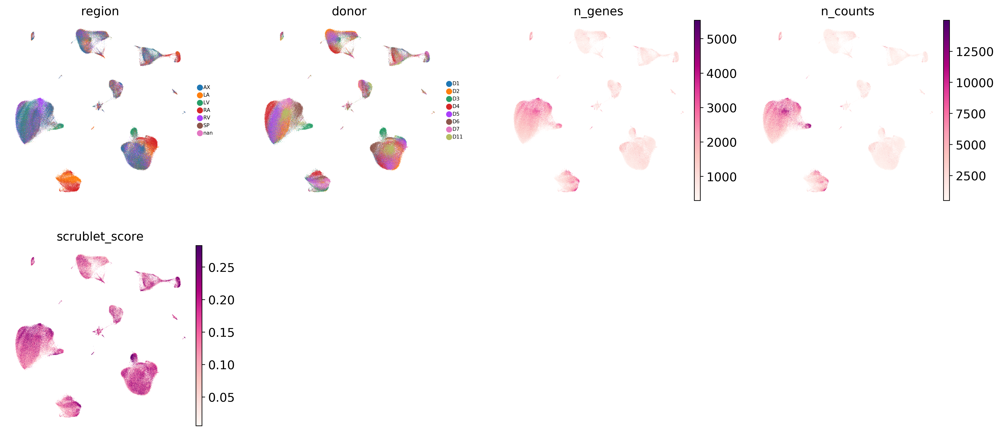

In [22]:
donor_hvg = nuclei_hvg.copy()
donor_bbknn = bbknn.bbknn(donor_hvg, neighbors_within_batch = 3, copy = True, batch_key = 'donor', approx = True, n_trees = 30)
sc.tl.umap(donor_bbknn, min_dist = 0.2, spread = 1.5, random_state = 1786)
sc.pl.umap(donor_bbknn, color = ['region', 'donor', 'n_genes', 'n_counts', 'scrublet_score'], size = 0.3, legend_fontsize = 6, color_map = 'RdPu', frameon = False)

### Correct for a combined key between _donor_ using PC-space regression prior to bbknn

- This function was developed by Krzysztof Polanski @ TeichLab. 

In [23]:
def regress_pca(pca, batch):
    regressors = np.zeros(pca.shape, dtype = 'float64')
    regressed = np.zeros(pca.shape, dtype = 'float64')
    for category in np.unique(batch):
        mask = (category == batch)
        regressors[mask,:] = np.mean(pca[mask,:],axis = 0)
    for i in range(pca.shape[1]):
        t = np.c_[np.ones(regressors[:,i].shape),regressors[:,i]]
        b = np.dot(np.dot(np.linalg.inv(np.dot(t.T,t)),t.T),pca[:,i])
        regressed[:,i] = pca[:,i] - b[0] - b[1] * t[:,1]
    return regressed

In [24]:
donor_lr_hvg = nuclei_hvg.copy()
donor_lr_hvg.obsm['X_pca_original'] = donor_lr_hvg.obsm['X_pca'].copy()
donor_lr_hvg.obsm['X_pca'] = regress_pca(donor_lr_hvg.obsm['X_pca'], donor_lr_hvg.obs['donor'])

computing batch balanced neighbors
	finished (0:02:33.31) --> added to `.uns['neighbors']`
	'distances', weighted adjacency matrix
	'connectivities', weighted adjacency matrix
computing UMAP
    using 'X_pca' with n_pcs = 50
    finished (0:05:45.39) --> added
    'X_umap', UMAP coordinates (adata.obsm)


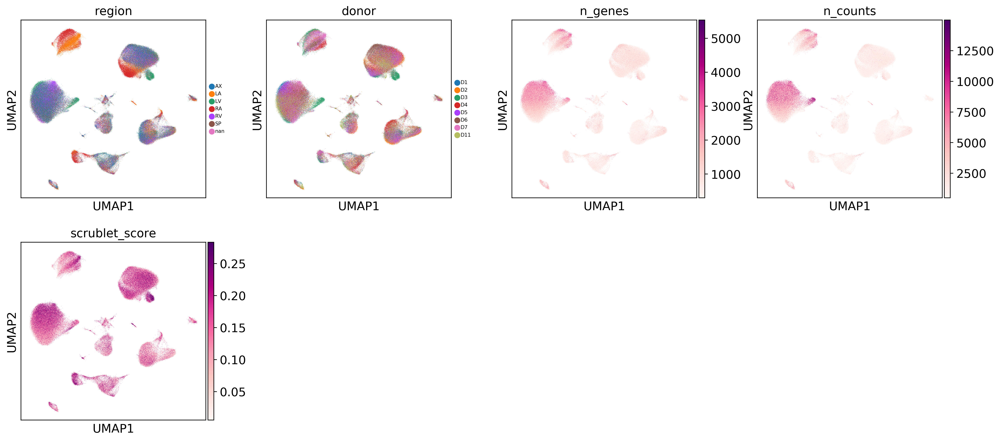

In [25]:
donor_lr_bbknn = bbknn.bbknn(donor_lr_hvg, neighbors_within_batch = 4, copy = True, batch_key = 'donor', approx = True, n_trees = 30)
sc.tl.umap(donor_lr_bbknn, min_dist = 0.4, spread = 1, random_state = 1786)
sc.pl.umap(donor_lr_bbknn, color = ['region', 'donor', 'n_genes', 'n_counts', 'scrublet_score'], size = 0.3, legend_fontsize = 6, color_map = 'RdPu')

/opt/conda/lib/python3.7/site-packages/anndata/core/anndata.py:299: FutureWarning: In anndata v0.7+, arrays contained within an AnnData object will maintain their dimensionality. For example, prior to v0.7 `adata[0, 0].X` returned a scalar and `adata[0, :]` returned a 1d array, post v0.7 they will return two dimensional arrays. If you would like to get a one dimensional array from your AnnData object, consider using the `adata.obs_vector`, `adata.var_vector` methods or accessing the array directly.
  warn_flatten()


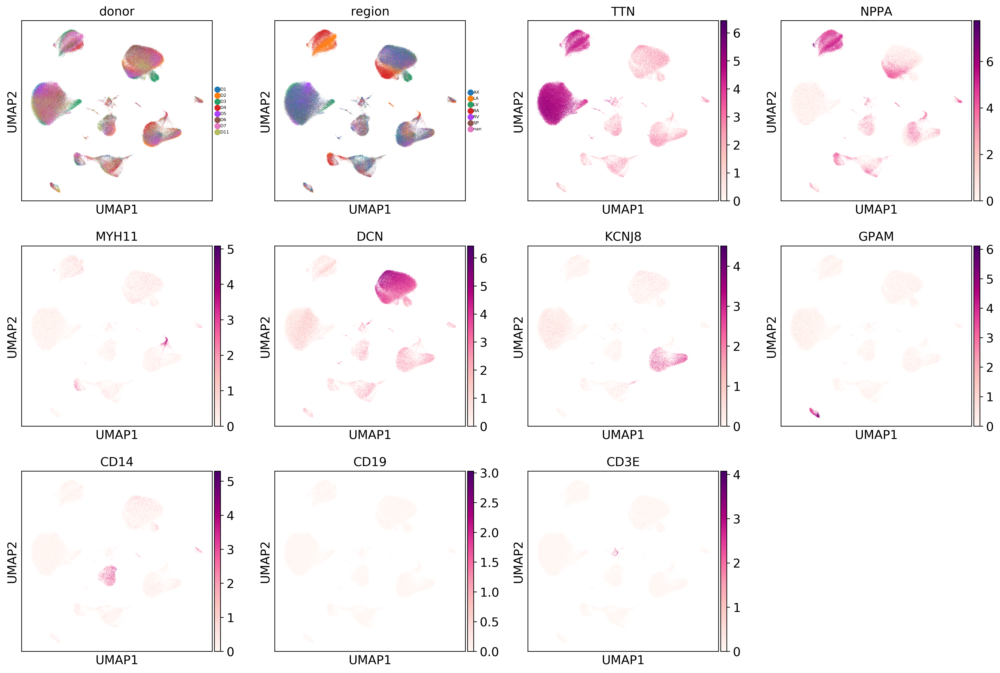

In [26]:
sc.pl.umap(donor_lr_bbknn, color = ['donor', 'region', 'TTN', 'NPPA', 'MYH11', 'DCN', 'KCNJ8', 'GPAM', 'CD14', 'CD19', 'CD3E'], size = 0.3, legend_fontsize = 5, color_map = 'RdPu')

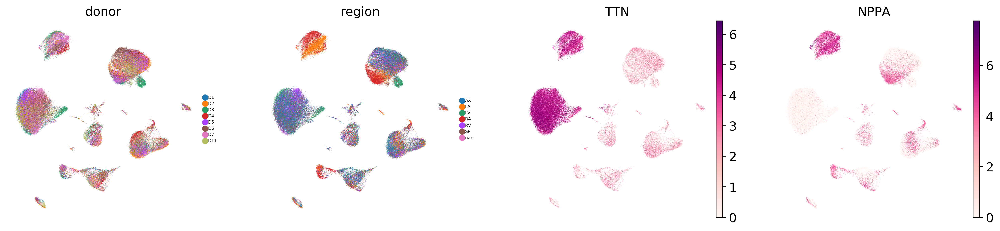

In [27]:
sc.pl.umap(donor_lr_bbknn, color = ['donor', 'region', 'TTN', 'NPPA'], size = 0.3, legend_fontsize = 5, color_map = 'RdPu', frameon = False)

/opt/conda/lib/python3.7/site-packages/seaborn/categorical.py:827: DeprecationWarning: np.asscalar(a) is deprecated since NumPy v1.16, use a.item() instead
  val = np.asscalar(support)
/opt/conda/lib/python3.7/site-packages/seaborn/categorical.py:828: DeprecationWarning: np.asscalar(a) is deprecated since NumPy v1.16, use a.item() instead
  d = np.asscalar(density)


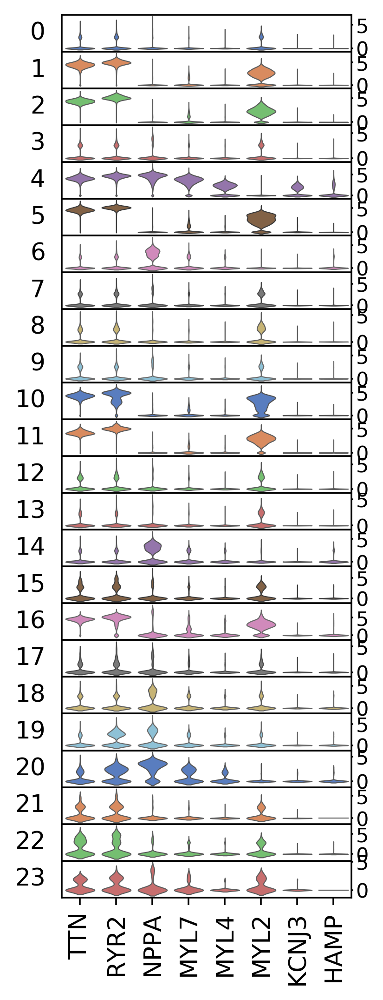

In [32]:
soupy_genes = ['TTN', 'RYR2', 'NPPA', 'MYL7', 'MYL4', 'MYL2', 'KCNJ3', 'HAMP']
sc.pl.stacked_violin(donor_lr_bbknn, soupy_genes, groupby = 'leiden')

### Check for apoptotic genes

/opt/conda/lib/python3.7/site-packages/anndata/core/anndata.py:299: FutureWarning: In anndata v0.7+, arrays contained within an AnnData object will maintain their dimensionality. For example, prior to v0.7 `adata[0, 0].X` returned a scalar and `adata[0, :]` returned a 1d array, post v0.7 they will return two dimensional arrays. If you would like to get a one dimensional array from your AnnData object, consider using the `adata.obs_vector`, `adata.var_vector` methods or accessing the array directly.
  warn_flatten()


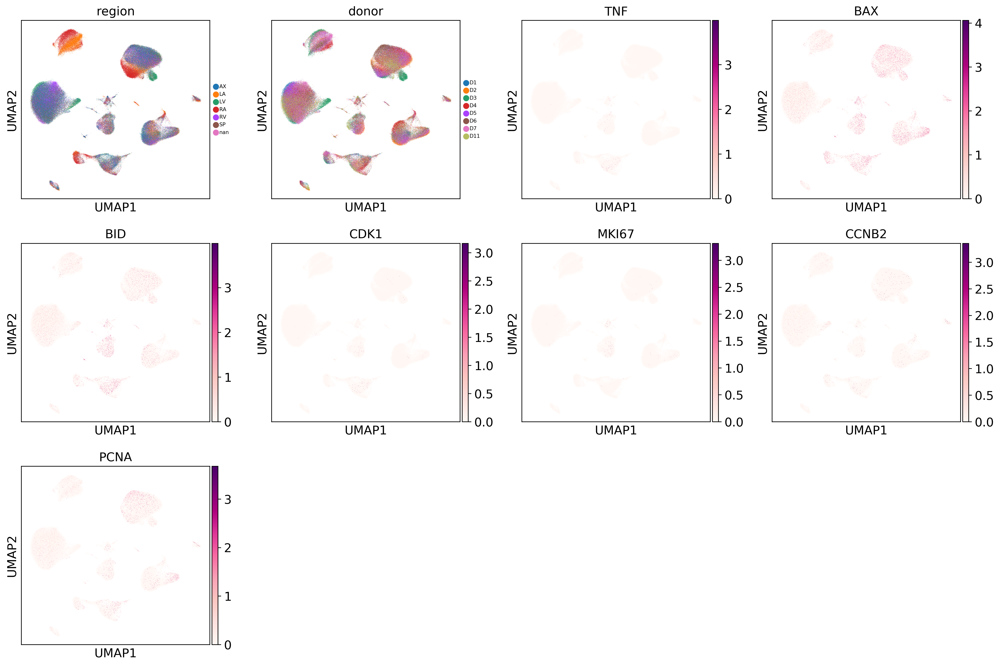

In [33]:
sc.pl.umap(donor_lr_bbknn, color = ['region', 'donor', 'TNF', 'BAX', 'BID','CDK1','MKI67','CCNB2','PCNA'], size = 0.3, legend_fontsize = 6, color_map = 'RdPu')

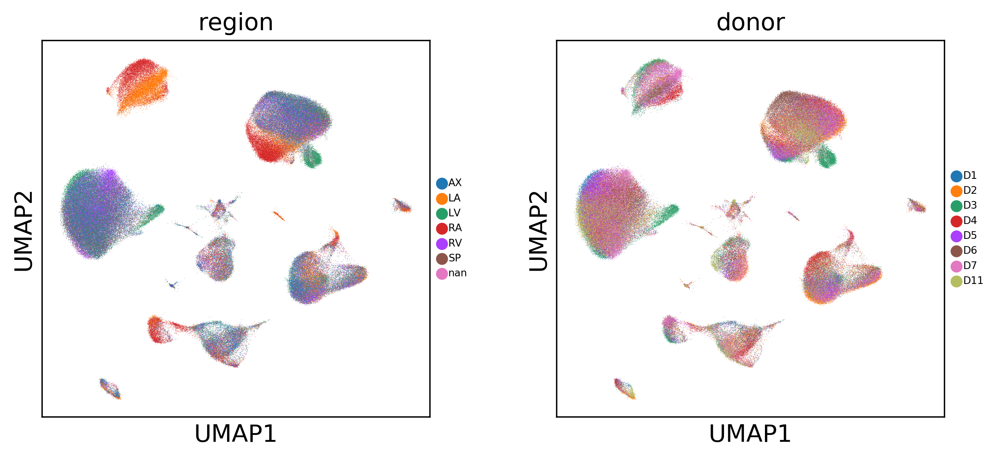

In [34]:
sc.pl.umap(donor_lr_bbknn, color = ['region', 'donor'], size = 0.3, legend_fontsize = 6, color_map = 'RdPu')

### Check for cell cycle genes

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden']`


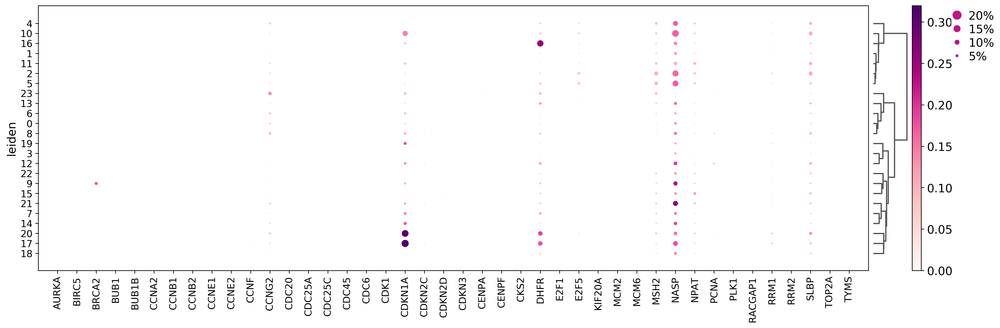

GridSpec(2, 5, height_ratios=[0, 10.5], width_ratios=[18.25, 0.8, 0.2, 0.5, 0.25])

In [35]:
whitehead_cell_cycle = ['AURKA','BIRC5','BRCA2','BUB1','BUB1B','CCNA2','CCNB1','CCNB2','CCNE1','CCNE2','CCNF','CCNG2','CDC20','CDC25A','CDC25C','CDC45','CDC6','CDK1','CDKN1A','CDKN2C','CDKN2D','CDKN3','CENPA','CENPF','CKS2','DHFR','E2F1','E2F5','KIF20A','MCM2','MCM6','MSH2','NASP','NPAT','PCNA','PLK1','RACGAP1','RRM1','RRM2','SLBP','TOP2A','TYMS']
sc.pl.dotplot(donor_lr_bbknn, whitehead_cell_cycle, groupby = 'leiden', dendrogram = True, color_map = 'RdPu', figsize = (20,6))

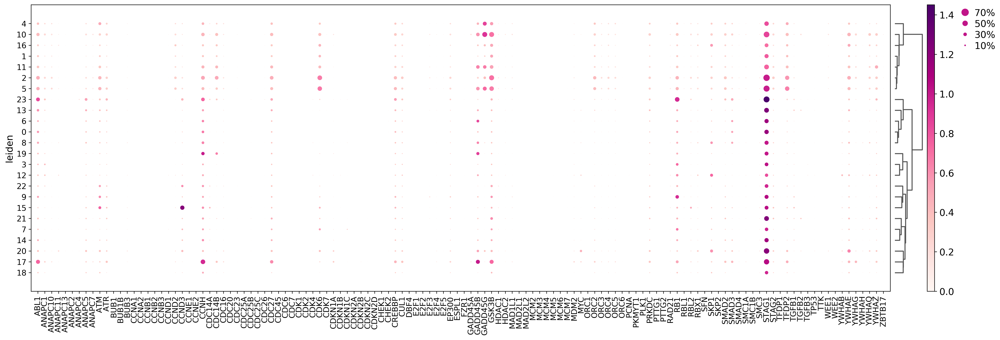

GridSpec(2, 5, height_ratios=[0, 10.5], width_ratios=[23.25, 0.8, 0.2, 0.5, 0.25])

In [36]:
kegg_cell_cycle = ['ABL1','ANAPC1','ANAPC10','ANAPC11','ANAPC13','ANAPC2','ANAPC4','ANAPC5','ANAPC7','ATM','ATR','BUB1','BUB1B','BUB3','CCNA1','CCNA2','CCNB1','CCNB2','CCNB3','CCND1','CCND2','CCND3','CCNE1','CCNE2','CCNH','CDC14A','CDC14B','CDC16','CDC20','CDC23','CDC25A','CDC25B','CDC25C','CDC26','CDC27','CDC45','CDC6','CDC7','CDK1','CDK2','CDK4','CDK6','CDK7','CDKN1A','CDKN1B','CDKN1C','CDKN2A','CDKN2B','CDKN2C','CDKN2D','CHEK1','CHEK2','CREBBP','CUL1','DBF4','E2F1','E2F2','E2F3','E2F4','E2F5','EP300','ESPL1','FZR1','GADD45A','GADD45B','GADD45G','GSK3B','HDAC1','HDAC2','MAD1L1','MAD2L1','MAD2L2','MCM2','MCM3','MCM4','MCM5','MCM6','MCM7','MDM2','MYC','ORC1','ORC2','ORC3','ORC4','ORC5','ORC6','PCNA','PKMYT1','PLK1','PRKDC','PTTG1','PTTG2','RAD21','RB1','RBL1','RBL2','RBX1','SFN','SKP1','SKP2','SMAD2','SMAD3','SMAD4','SMC1A','SMC1B','SMC3','STAG1','STAG2','TFDP1','TFDP2','TGFB1','TGFB2','TGFB3','TP53','TTK','WEE1','WEE2','YWHAB','YWHAE','YWHAG','YWHAH','YWHAQ','YWHAZ','ZBTB17']
sc.pl.dotplot(donor_lr_bbknn, kegg_cell_cycle, groupby = 'leiden', dendrogram = True, color_map = 'RdPu', figsize = (25,8))

## Annotate Leiden clusters 

In [29]:
sc.tl.leiden(donor_lr_bbknn, resolution = 1.5, random_state = 1712)

running Leiden clustering
    finished (0:11:02.68) --> found 24 clusters and added
    'leiden', the cluster labels (adata.obs, categorical)


In [30]:
donor_lr_bbknn.obs['leiden'].cat.categories

Index(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12',
       '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23'],
      dtype='object')

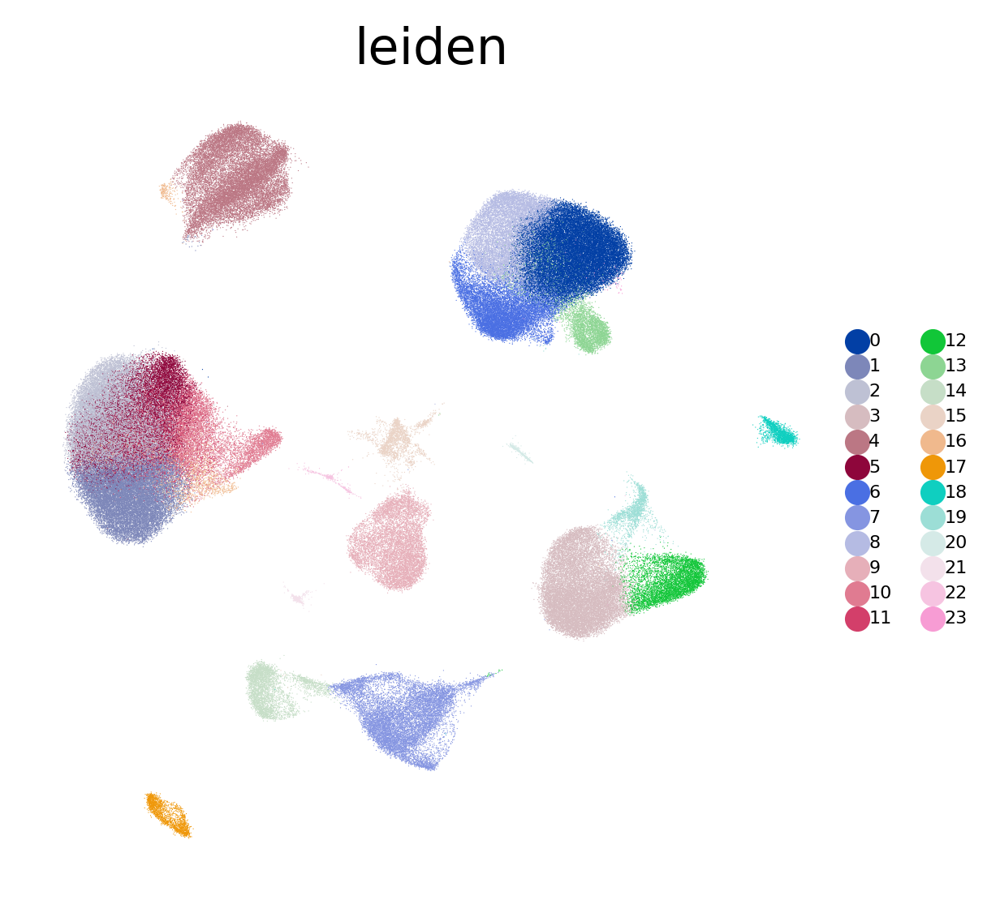

In [31]:
sc.pl.umap(donor_lr_bbknn, color = ['leiden'], size = 0.3, legend_fontsize = 5, color_map = 'RdPu', frameon = False)

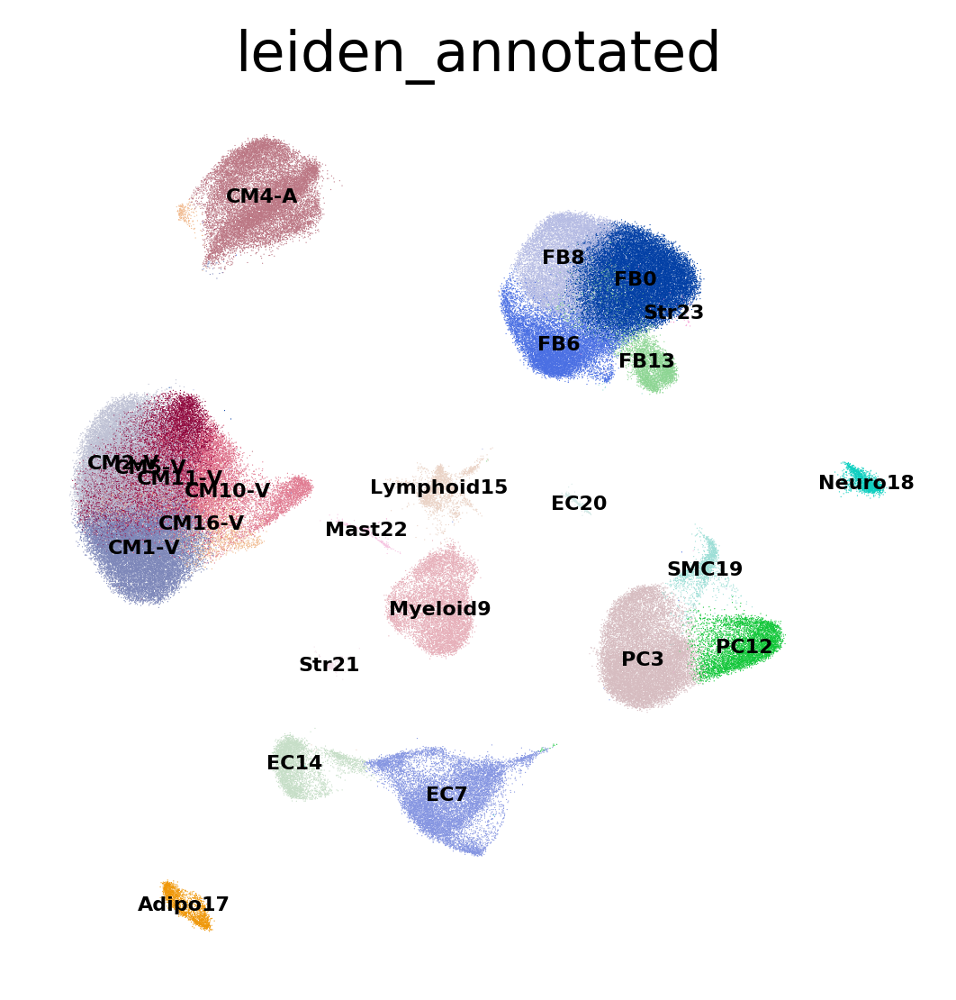

In [42]:
donor_lr_bbknn.obs['leiden_annotated'] = donor_lr_bbknn.obs['leiden']
donor_lr_bbknn.obs['leiden_annotated'].cat.categories = ['FB0', 'CM1-V', 'CM2-V', 'PC3', 'CM4-A', 'CM5-V', 'FB6', 'EC7', 'FB8', 'Myeloid9', 'CM10-V', 'CM11-V', 'PC12', 'FB13', 'EC14', 'Lymphoid15', 'CM16-V', 'Adipo17', 'Neuro18', 'SMC19', 'EC20', 'Str21', 'Mast22', 'Str23']
sc.pl.umap(donor_lr_bbknn, color = ['leiden_annotated'], size = 0.3, legend_fontsize = 5, legend_loc = 'on data', frameon = False)

### Call markers on Leiden

In [37]:
sc.tl.rank_genes_groups(donor_lr_bbknn, 'leiden', method = 'wilcoxon', n_genes = 500)
result = donor_lr_bbknn.uns['rank_genes_groups']
groups = result['names'].dtype.names
wilcox_markers = pd.DataFrame(
{group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names','logfoldchanges', 'pvals_adj']})
wilcox_markers.head(10)

ranking genes
    finished (0:12:22.70) --> added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids


,0_n,0_l,0_p,1_n,1_l,1_p,2_n,2_l,2_p,3_n,...,20_p,21_n,21_l,21_p,22_n,22_l,22_p,23_n,23_l,23_p
0,ABCA8,4.400598,0.0,TTN,3.698379,0.0,RYR2,4.336023,0.0,DLC1,...,9.182207e-289,CCL21,11.112703,8.939145e-206,NTM,6.567438,1.565900e-137,DLC1,3.289688,3.378386e-29
1,NEGR1,4.495132,0.0,SLC8A1,3.180890,0.0,FHL2,3.794281,0.0,PDGFRB,...,2.528899e-256,PPFIBP1,3.726312,7.768442e-170,SLC24A3,5.812817,3.761933e-108,FRMD3,3.353114,5.828817e-19
2,DCN,4.041901,0.0,RYR2,3.992769,0.0,SORBS2,3.604194,0.0,FRMD3,...,3.657775e-252,PKHD1L1,7.497949,1.147156e-150,KIT,10.063825,1.017631e-71,RORA,2.741814,7.165327e-18
3,ABCA6,4.358640,0.0,SORBS2,3.284278,0.0,TRDN-AS1,3.376866,0.0,PRKG1,...,2.454884e-230,MMRN1,10.329065,7.100035e-150,SMYD3,3.252179,3.619733e-66,EBF1,2.968965,1.090977e-16
4,RORA,3.205265,0.0,CTNNA3,3.087775,0.0,MYOM1,3.354142,0.0,NR2F2-AS1,...,2.594466e-229,TFPI,4.191207,2.571471e-141,TPSB2,9.803388,1.511354e-51,NEGR1,3.017928,2.752629e-15
5,LAMA2,2.268014,0.0,MYBPC3,3.085603,0.0,SLC8A1,3.391068,0.0,EGFLAM,...,7.083593e-220,ST6GALNAC3,5.037632,1.553812e-120,ARHGAP15,3.654636,2.710388e-51,ABCA6,3.033388,6.887224e-15
6,C7,3.790459,0.0,FHL2,3.189181,0.0,SGCD,3.142081,0.0,PLA2G5,...,2.948936e-218,LDB2,4.330717,4.149032e-116,HDC,9.605496,4.158516e-49,PLA2G5,2.879144,6.887224e-15
7,BICC1,3.925768,0.0,TNNT2,2.692707,0.0,PDLIM5,2.976892,0.0,EPS8,...,2.197092e-211,KALRN,3.501015,6.608126e-100,SYTL3,4.604377,5.597143e-47,DCN,2.734919,2.304423e-14
8,CFD,3.322957,0.0,TRDN-AS1,2.917804,0.0,CTNNA3,3.278178,0.0,GUCY1A2,...,1.469036e-194,STOX2,4.069767,3.090137e-98,FER,2.926597,1.505278e-45,NR2F2-AS1,2.981272,4.465524e-14
9,ABCA9,3.916945,0.0,LDB3,2.850534,0.0,MYBPC3,3.311870,0.0,PDZD2,...,2.021242e-194,SEMA3A,4.840552,5.154646e-91,TNIK,2.679277,1.850254e-39,PDGFRB,2.946357,1.400276e-13


In [38]:
wilcox_markers.to_csv('/home/jovyan/experiments/1-annotated_objects/hca_heart_NucSeq_191209_wilcox_leiden.csv', index = False)

### Save annotated object 

In [ ]:
donor_lr_bbknn_raw = anndata.AnnData(X = sanger_nuclei.X , obs = donor_lr_bbknn.obs, var = sanger_nuclei.var, obsm = donor_lr_bbknn.obsm)
donor_lr_bbknn_raw.raw = nuclei_raw.copy()
donor_lr_bbknn_raw.write('/home/jovyan/experiments/1-annotated_objects/sanger_heart_NucSeq_annotated_ctl191209.h5ad')

In [ ]:
sc.pl.umap(donor_lr_bbknn_raw, color = ['leiden_annotated', 'NPPA'], size = 0.3, legend_fontsize = 5, legend_loc = 'on data', frameon = False, use_raw = True)

In [ ]:
samplexcell = pd.crosstab(donor_lr_bbknn_raw.obs['sample'], donor_lr_bbknn_raw.obs['leiden_annotated'])
samplexcell.to_csv('/home/jovyan/experiments/1-annotated_objects/hca_heart_NucSeq_annotated_ctl191209_tabulated.csv', index = True)